# Lab 6: NumPy and Image Processing (Part 1!)

## Starter Code

This portion of the lab involves processing a few images. **Download the starter code to have access to those images: [https://drive.google.com/open?id=1se0J5yFRWj-Y7mv9KhUO5xv04a7s84fZ](https://drive.google.com/open?id=1se0J5yFRWj-Y7mv9KhUO5xv04a7s84fZ)**.

## Overview
In this lab, we'll explore many of the applications of Python that we've been covering over the last few weeks. We'll use `numpy`, together with `Pillow`, to do some cool image manipulation tasks. 

Some people were concerned about this on the MQE: we don't expect you to finish all of the material here in one class period. If you do - great! But if not, you are encouraged to work through the extra material at your own pace - it explores interesting and intriguing aspects of `numpy`.

## Warming Up

### Creating ndarrays

`numpy` is **super** versatile in part because there are several different ways to construct arrays. We've listed a few below. Explore and test them out!

In [2]:
import numpy as np

In [2]:
np.array([[1, 2], [3, 4], [5, 6]])

array([[1, 2],
       [3, 4],
       [5, 6]])

In [3]:
"""
Signature:
    np.random.random(size=None)
    
Docstring: 
    Return random floats in the half-open interval [0.0, 1.0). Alias for
    `random_sample` to ease forward-porting to the new random API.
"""
np.random.random((3, 2))

array([[0.13936135, 0.19390092],
       [0.16084916, 0.38572897],
       [0.96338271, 0.2195067 ]])

In [4]:
"""
Signature:
    np.linspace(
        start,
        stop,
        num=50,
        endpoint=True,
        retstep=False,
        dtype=None,
        axis=0,
    )
    
Docstring:
    Return evenly spaced numbers over a specified interval.

    Returns `num` evenly spaced samples, calculated over the
    interval [`start`, `stop`].

    The endpoint of the interval can optionally be excluded.
"""
np.linspace(2, 10, 15)

array([ 2.        ,  2.57142857,  3.14285714,  3.71428571,  4.28571429,
        4.85714286,  5.42857143,  6.        ,  6.57142857,  7.14285714,
        7.71428571,  8.28571429,  8.85714286,  9.42857143, 10.        ])

In [5]:
"""
Signature: 
    np.full(shape, fill_value, dtype=None, order='C')
    
Docstring:
    Return a new array of given shape and type, filled with `fill_value`.
"""
np.full((2, 5), True)

array([[ True,  True,  True,  True,  True],
       [ True,  True,  True,  True,  True]])

In [6]:
"""
Signature:
    np.zeros(shape, dtype=float, order='C')

Docstring:
    Return a new array of given shape and type, filled with zeros.
"""
np.zeros((2, 5))

array([[0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0.]])

### `np.array`, unpacked
Let's take a longer look at the `np.array` documentation.

```
np.array(object, dtype=None, copy=True, order='K', subok=False, ndmin=0)

Create an array.

Parameters
----------
object : array_like
    An array, any object exposing the array interface, an object whose
    __array__ method returns an array, or any (nested) sequence.
dtype : data-type, optional
    The desired data-type for the array.  If not given, then the type will
    be determined as the minimum type required to hold the objects in the
    sequence.  This argument can only be used to 'upcast' the array.  For
    downcasting, use the .astype(t) method.
copy : bool, optional
    If true (default), then the object is copied.  Otherwise, a copy will
    only be made if __array__ returns a copy, if obj is a nested sequence,
    or if a copy is needed to satisfy any of the other requirements
    (`dtype`, `order`, etc.).
order : {'K', 'A', 'C', 'F'}, optional
    Specify the memory layout of the array. If object is not an array, the
    newly created array will be in C order (row major) unless 'F' is
    specified, in which case it will be in Fortran order (column major).
    If object is an array the following holds.

    ===== ========= ===================================================
    order  no copy                     copy=True
    ===== ========= ===================================================
    'K'   unchanged F & C order preserved, otherwise most similar order
    'A'   unchanged F order if input is F and not C, otherwise C order
    'C'   C order   C order
    'F'   F order   F order
    ===== ========= ===================================================

    When ``copy=False`` and a copy is made for other reasons, the result is
    the same as if ``copy=True``, with some exceptions for `A`, see the
    Notes section. The default order is 'K'.
subok : bool, optional
    If True, then sub-classes will be passed-through, otherwise
    the returned array will be forced to be a base-class array (default).
ndmin : int, optional
    Specifies the minimum number of dimensions that the resulting
    array should have.  Ones will be pre-pended to the shape as
    needed to meet this requirement.
```

#### `dtype`
We in class saw how `numpy` requires each element of an array to have the same data type. If they have different data types then `numpy` will guess at the type for the array. 

Guess how `numpy` will resolve the data types in the following arrays. Are the outputs what you expect?

In [7]:
np.array([1.5, True, 'unicorn'])

array(['1.5', 'True', 'unicorn'], dtype='<U32')

In [8]:
np.array([1.5, True])

array([1.5, 1. ])

In [9]:
np.array([1.5, True, [1.5, True]]) # What's going on here?

array([1.5, True, list([1.5, True])], dtype=object)

In [10]:
np.array([1.5, True, {1.5, True}]) # What's going on here?

array([1.5, True, {1.5, True}], dtype=object)

In [11]:
def fibbi():
    a, b = 0, 1
    while True:
        a, b = b, a+b
        yield a

g = fibbi()
np.array([1.5, True, g]) # This also seems strange...

array([1.5, True, <generator object fibbi at 0x7fec78516350>],
      dtype=object)

In [12]:
np.array(g) # This also seems strange...

array(<generator object fibbi at 0x7fec78516350>, dtype=object)

We can control the data type of a `numpy` array by tuning with the `dtype` parameter. You can s

In [13]:
np.array([1.5, True], dtype=bool)

array([ True,  True])

In [14]:
def fibbi():
    a, b = 0, 1
    while True:
        a, b = b, a+b
        yield a

g = fibbi()
np.array([1.5, True, g], dtype=bool)

array([ True,  True,  True])

In [15]:
np.array([1.5, True], dtype=np.dtype('b')) # bytes, native byte order (what happens?)

array([1, 1], dtype=int8)

#### `copy`
By default, when you reassign an array, `numpy` will make a copy of that array. If you want to change the original array, you can set `copy=False` or use `asarray` (which is an alias for that).

In [16]:
arr = np.ones((3, 2))
copy = np.array(arr)
copy[0, 0] = 0

print(copy)
print(arr)

[[0. 1.]
 [1. 1.]
 [1. 1.]]
[[1. 1.]
 [1. 1.]
 [1. 1.]]


In [17]:
arr = np.ones((3, 2))
copy = np.asarray(arr)
copy[0, 0] = 0

print(copy)
print(arr)

[[0. 1.]
 [1. 1.]
 [1. 1.]]
[[0. 1.]
 [1. 1.]
 [1. 1.]]


## Instagram Filters
Parth has been working on upping his Instagram game, and he needs your help! The functions below take in a NumPy array which composes a photo of Parth, Sam, and Michael from Viennese Ball this year, and returns another NumPy array of a filtered version of the photo. The filters are described in Markdown cells above the cell in which you implement the function. Implement the functons as described to apply the described filters to the photo, and to learn more about NumPy indexing!

In [3]:
# Run this cell which contains functions to extract NumPy representations of images and save NumPy arrays as images.
# You do not need to edit anything in this file.
from PIL import Image

def load_image(infilename) :
    img = Image.open(infilename)
    data = np.array(img)
    return data

def save_image(npdata, outfilename) :
    img = Image.fromarray(npdata.astype('uint8'))
    img.save(outfilename)

Here is the original photo of Parth, Sam, and Michael:
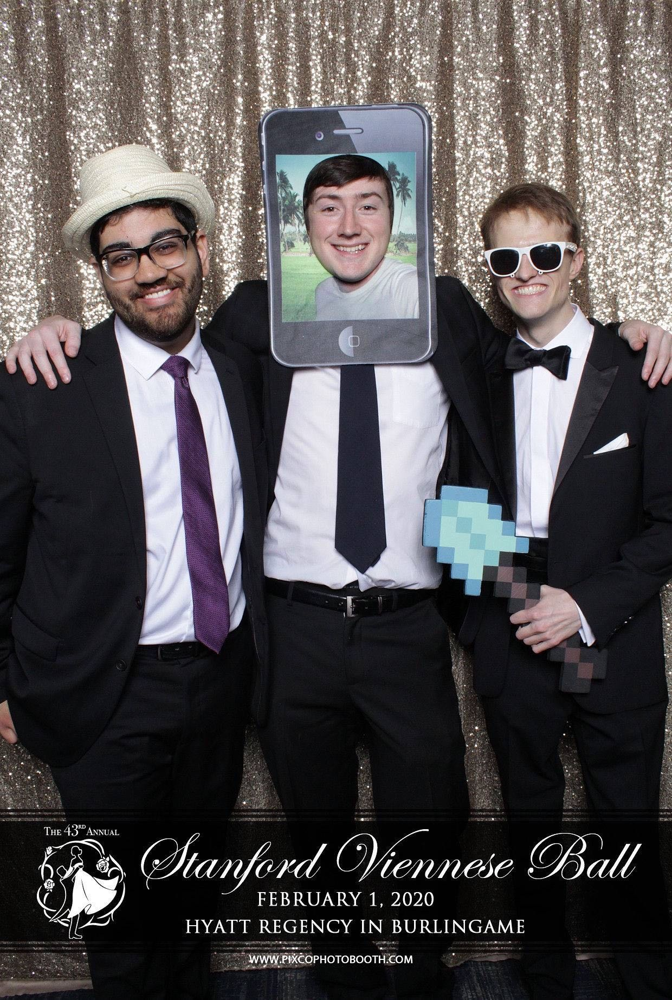

```crop_img```: Open up cs41img.png (in the same directory as this lab notebook) in your photo viewer/editor
    of choice. Guesstimate the approximate locations of the pixels forming a rectangle around
    Parth's face. Slice the input NumPy array, `img`, such that the output NumPy array represents a
    cropped version of the image containing only Parth's face. The final output image should look 
    something like this:
    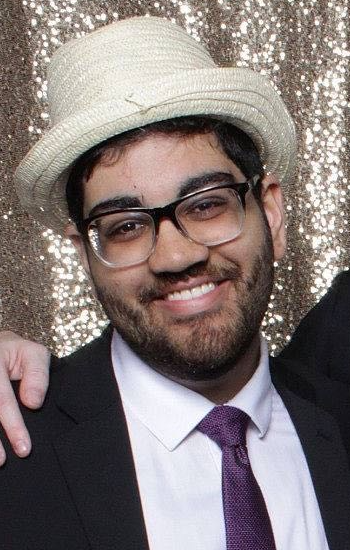

To test your implementation, run the cell below! It will load, edit, and save the modified image to your computer in the same directory as this notebook.

In [20]:
# (240, 100), (240, 420), (690, 100), (690, 420)
def crop_img(img):
    # Implement your function here
    cropped_img = img[240:690, 100:420, :]
    return cropped_img

img = load_image("cs41img.png").copy()
save_image(crop_img(img), "cs41img_cropped.png")

`green_img`: Slice the input NumPy array, `img`, such that the returned NumPy array represents an image containing
only the green channel from the original image. Important note: the dimensions of the input image are (M, N, 3). Your
output NumPy array must also be of dimensions (M, N, 3); however, the red and blue channels are to be zeroed out. If
you return an (M, N, 1) NumPy array, PIL will reconstruct this as a black-and-white photo rather than interpreting
it as only the green channel of the image. Important hint: to stack together several channels, consider the `np.stack` function: if passed in a tuple of (M, N) matrices, it will create an (M, N, 2) matrix by concatenating them along a new axis.

The output image should look something like this:
    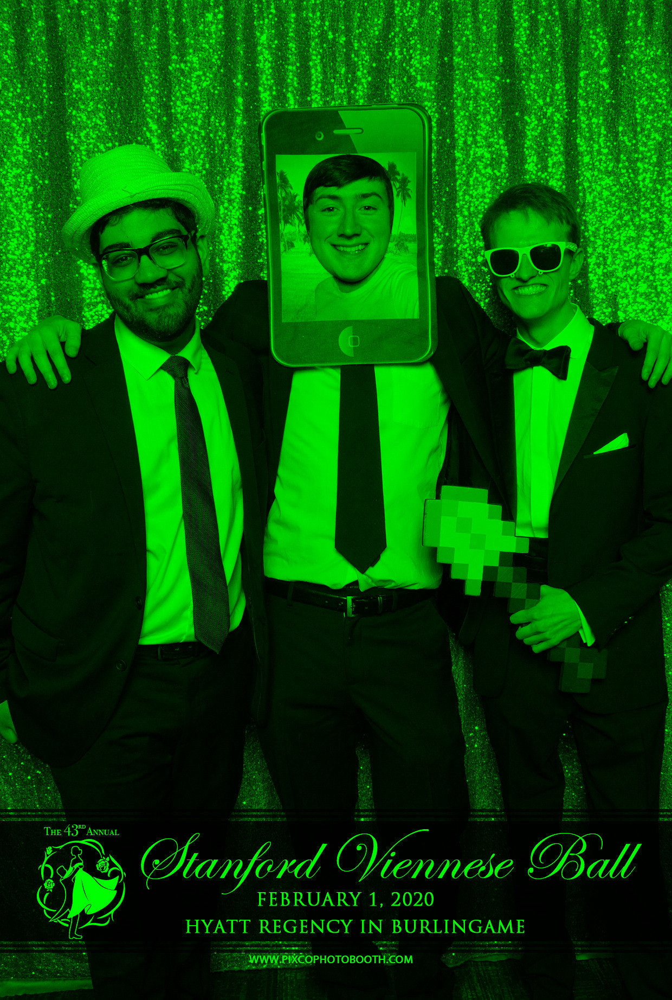



In [24]:
def green_img(img):
    # Implement your function here
    recolored_mask = np.zeros(img.shape, dtype=bool)
    recolored_mask[:, :, [0, 2]] = True
    img[recolored_mask] = 0
    return img

img = load_image("cs41img.png").copy()
save_image(green_img(img), "cs41img_green.png")

`third_third_third`: Using your knowledge from the prior two problems, create a version of the image in which
the top third contains only the red channel, the middle third contains only the blue channel, and the bottom third
contains only the green channel. Hint: in addition to using `np.stack` (which you might have used in the prior
problem), consider also using `np.concatenate`. If passed in a tuple of NumPy arrays and an axis argument, it will
return a NumPy array consisting of the NumPy arrays in the tuple concatenated together along the specified axis. Your output image should look something like this:
    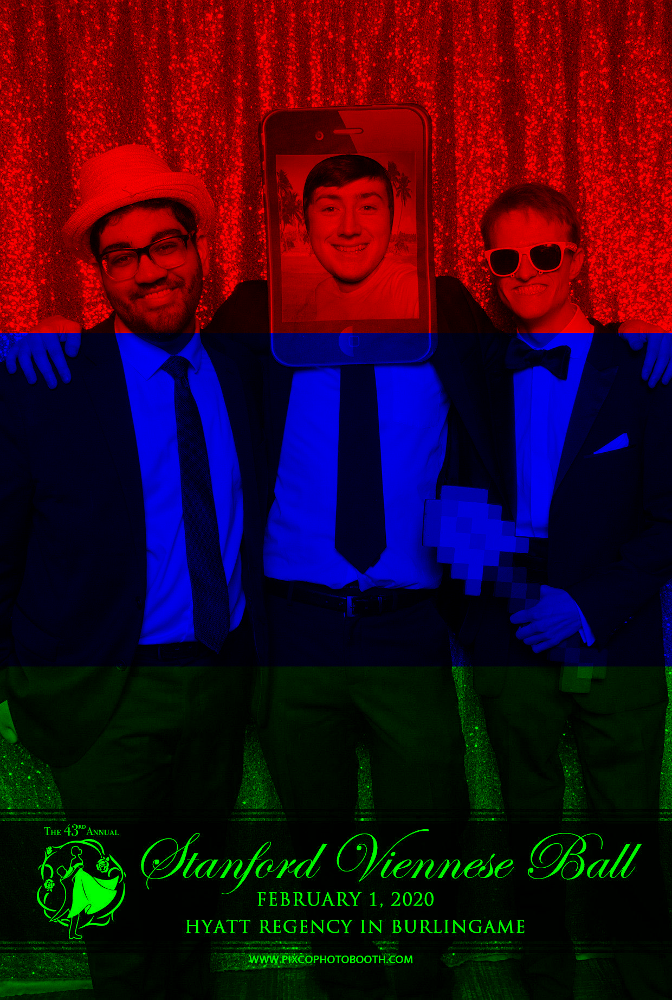



In [27]:

def third_third_third(img):
    # Implement your function here
    rows, cols, colors = img.shape
    img[:rows//3, :, [0, 1]] = 0
    img[rows//3:2*rows//3, :, [1, 2]] = 0
    img[2*rows//3:, :, [2, 0]] = 0
    return img

img = load_image("cs41img.png").copy()
save_image(third_third_third(img), "cs41img_third.png")

These next two functions - `brightness` and `contrast` - are really neat, since these are image editing techniques which feature in production image editing software (and apps like Instagram and the iPhone Photos app)!

`brightness`: the first thing that you'll note about this function is that, in addition to a NumPy array
representing an image, it takes in a factor. Scale the brightness of the image by multiplying every element
in the image array by the given factor. If this operation results in an element the value of which is greater than
255, set the value of that pixel to 255. Then return the NumPy array representing the brightened image. If this function is called with the factor we use below (1.5), the output image should look something like this:
    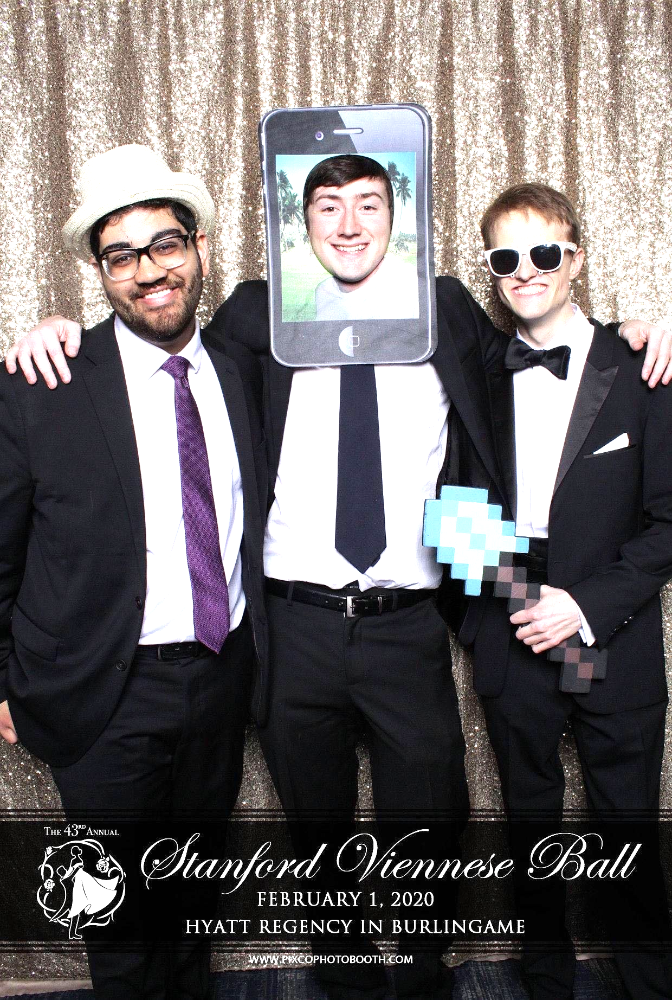

Also note that depending upon your implementation, `brightness` may take a minute or so to run.

In [28]:

def brightness(img, factor):
    # Implement your function here
    img = img * factor
    mask = img > 255
    img[mask] = 255
    return img

img = load_image("cs41img.png").copy()
save_image(brightness(img, 1.5), "cs41img_bright.png")

`brightness_PIL`: it turns out that for many image processing tasks, like this one, NumPy isn't necessarily the best way to go. You'll recall that your implementation of `brightness` likely took a few minutes to run. Can we use Python's image processing libraries to speed up the computation time and make our code even more pythonic?

Take a moment and check out the `Image.point()` function included with `PIL`. It takes in a lambda (which takes in one argument), then applies that lambda to each point (R, G, B value) in the image. So now that we've implemented our solution to `brightness` above, how might we implement `brightness_PIL`, which makes use of this functionality from `PIL` in order to achieve the same effect?

In [30]:

def brightness_PIL(img, factor):
    # Implement your function here
    return img.point(lambda x: min(255, x * factor))

img = brightness_PIL(Image.open("cs41img.png"), 1.5)
img.save("cs41img_bright_PIL.png")


`contrast`: approach this function in a similar way to `brightness`, but with one key difference. If the value of a given element in the NumPy array is less than 128, update the value by dividing it by the given factor. If the value of the element is greater than 128, update the value by multiplying it by the given factor. In this way, you create greater divergence between elements depending on whether they are greater or less than the middle value of the acceptable range. Once you've finished implementing this function, the output image should look something like this:
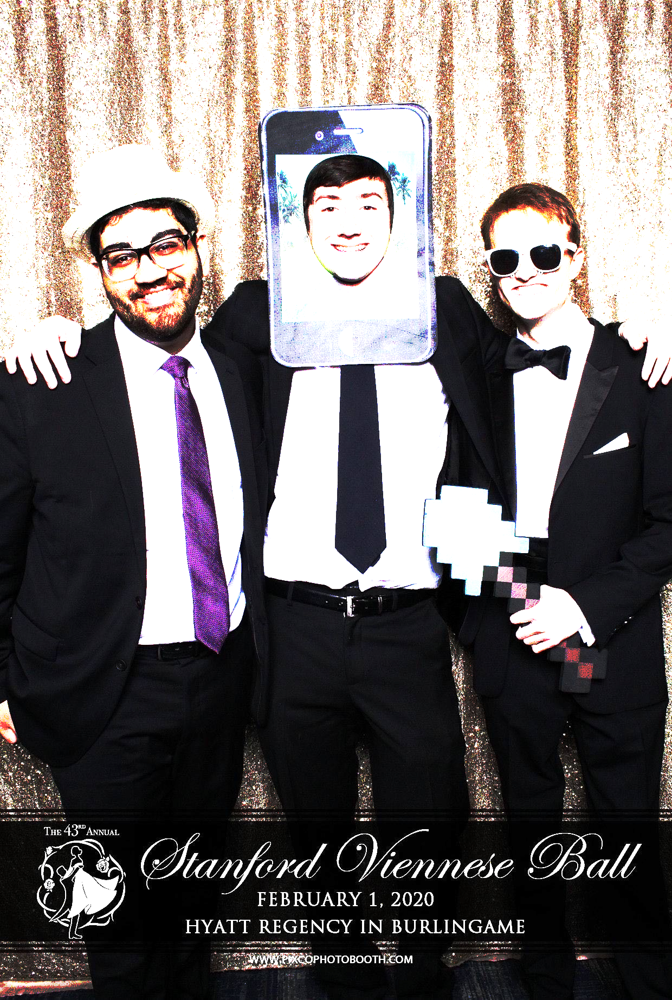
Also note that depending upon your implementation, `contrast` may take a minute or so to run.

In [30]:
def contrast(img, factor):
    # Implement your function here
    multiply_mask = img < 128
    img[multiply_mask] = img[multiply_mask] / factor
    img[~multiply_mask] = img[~multiply_mask] * factor
    too_large_mask = img > 255
    img[too_large_mask] = 255
    return img

img = load_image("cs41img.png").copy()
save_image(contrast(img, 1.5), "cs41img_contrast.png")

## Image Reconstruction
Oh no!! During the photo shoot at Viennese Ball, the oh-so-cute (but oh-so-mischevious!) Unicornelius managed to sneak into the photos during the photo shoot! The photographer managed to take three photos of the group, but in each photo, the face of one of Parth, Sam, or Michael is obscured. See the three images below:
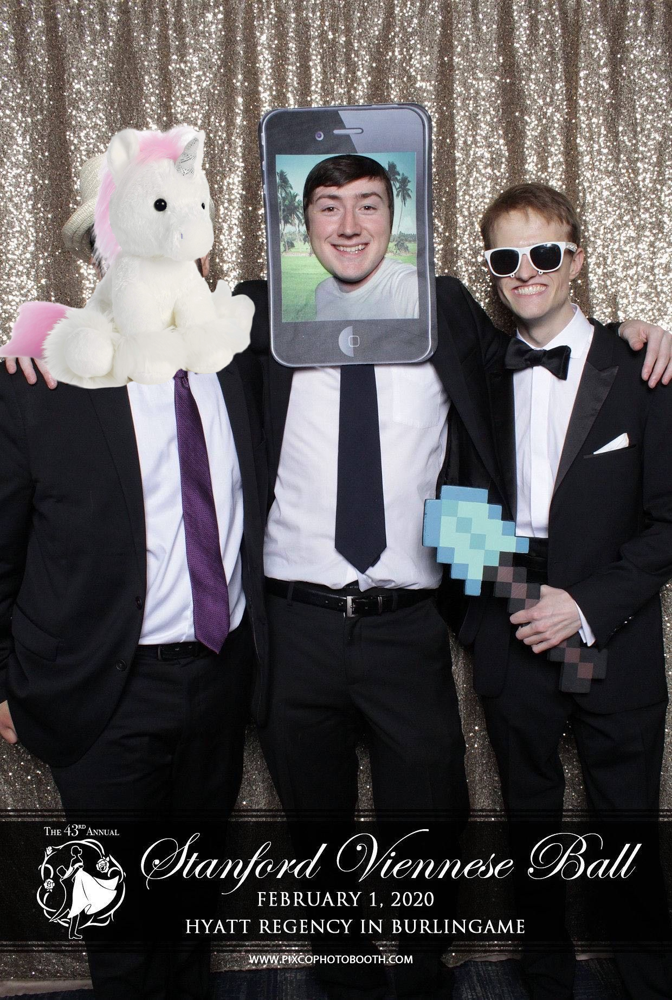
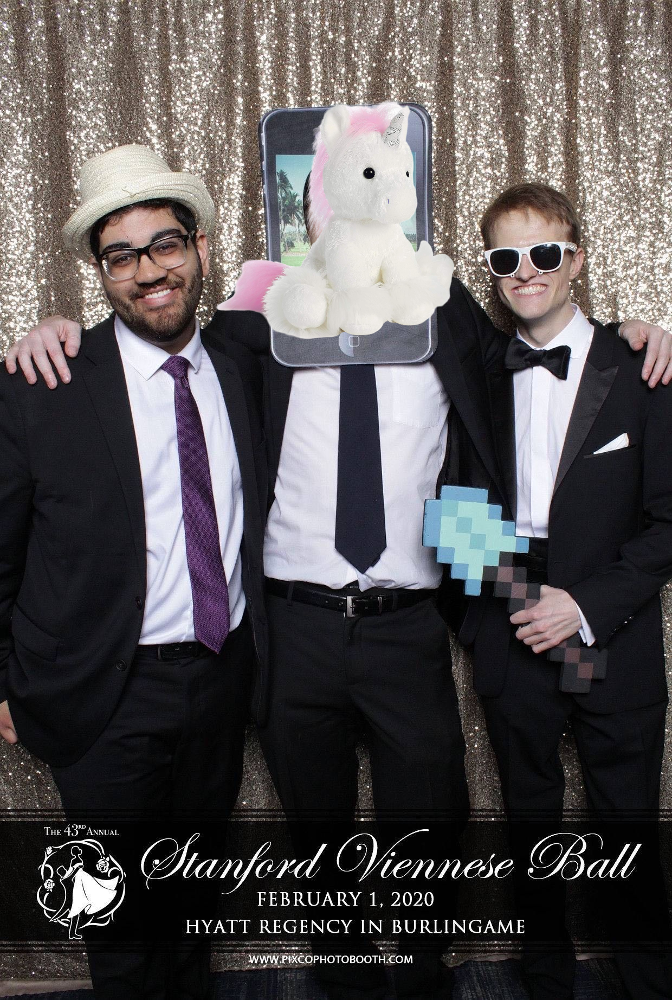
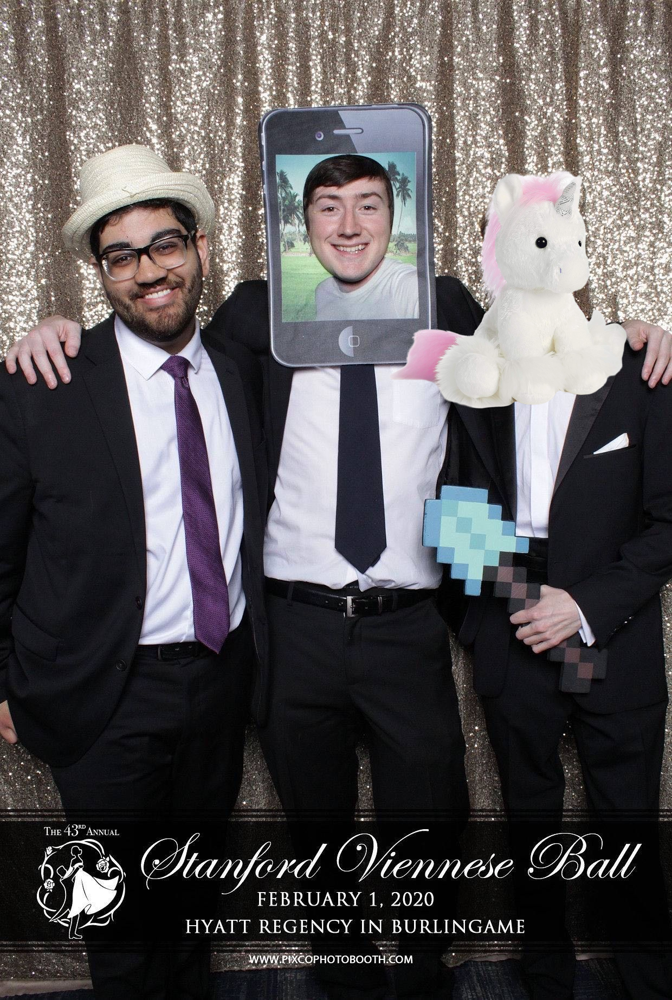

The function below, `reconstruct`, takes in three NumPy arrays, one representing each image. Working with your lab group (or in partners), devise and implement a simple reconstruction algorithm, such that the `reconstruct` function returns an image of Parth, Sam, and Michael without Unicornelius. Your final image should look like the original photo, below:
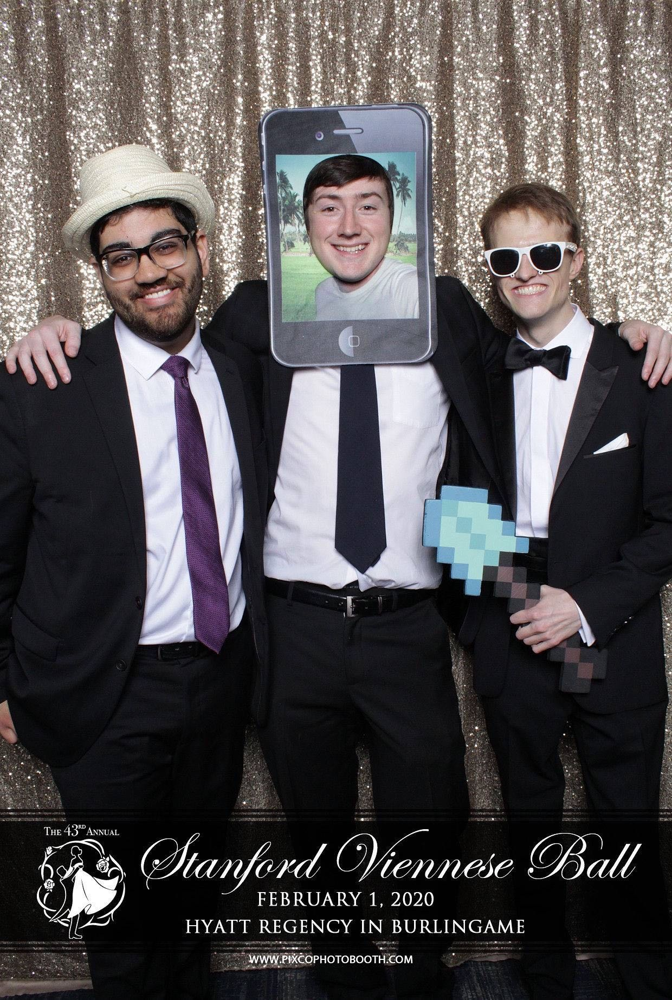


In [33]:
def reconstruct(img1, img2, img3):
    # Implement your function here
    # just use first and third pics, slice down the middle
    rows, cols, colors = img1.shape
    first_half = img3[:, :cols//2, :]
    second_half = img1[:, cols//2:, :]
    reconstructed_img = np.concatenate([first_half, second_half], axis = 1)
    return reconstructed_img

img1 = load_image("SOLcs41img_unicorn1.png").copy()
img2 = load_image("SOLcs41img_unicorn2.png").copy()
img3 = load_image("SOLcs41img_unicorn3.png").copy()

save_image(reconstruct(img1, img2, img3), "cs41img_reconstructed.png")

## Ascii Art
Now, let's convert an image to ASCII art! A neat way to do this is to convert each pixel of the image to a character based on its value (since our image is black and white, each pixel only has one value, between 0 and 255) where the darker pixels get converted to darker characters. 

Let's split `range(256)` into four parts, and assign each part to a character of varying darkness. Use the following rules to convert each pixel to an ASCII character:
```
px  < 64:          '▓'
64  <= px < 128:   '▒'
128 <= px < 192:   '░'
192 <= px:         ' '
```
(that last character is a space)

The `bisect` library might be helpful for this. Do this for every pixel in `a`. Then, you should be able to join the characters within each of the rows with `''` and join the rows with `'\n'` to get the final output. That'll be something like:

```python
'\n'.join(''.join(row) for row in ascii_array)
```

We've stored the characters and breakpoints in two lists:

In [ ]:
import bisect
characters = '▓▒░ '
breakpoints = [64, 128, 192]

# Convert the image (called unicorn_ascii.png, stored in the same directory as this notebook)
# to ASCII and print it out.
#
# Hint - to load the image, you can call the image loader functions that we've defined above!

My heart... 😍

There's one more detail that we can improve to get better results. Each pixel is *square*, but we're replacing it with characters like `'▓'`, which are taller than they are wide. To compensate for this, we can increase the width of the image, convert that to a `numpy` array, and *then* convert the array to ASCII.

You can do this with
```python
im = im.resize((int(im.size[0]*1.5), im.size[1])) # scale width by 1.5
stretched_arr = np.asarray(im)
... # convert to ascii
```

You're done with this part of the lab, but if you want to go back above and modify your previous code, be my guest!

> "So... what can I do with ASCII art, Parth?" you might say.
> 
> Marvel at it of course! Tell your family, your friends, the world must know!
> After that's done, you can edit `/etc/motd` (stands for Message Of The Day) if you're on a MacOS or Linux computer and put the ASCII art there. Then, every time you open a terminal, the art will print out first! You may need to edit with `sudo`, so one option would be `$ sudo nano /etc/motd`.
> My MOTD is:
```
                                            |
                                           \ /
                      ~~%%%%%%%%_,_,    --_,* ---
                   ~~%%%%%%%%%*"/./   _,=" / \
                 ~~%%%%%%%*'   /  *.="      |
              ~~%%%%%%%%*  .    ,__*.
            ~~%%%%%%%%*   *      \O\*
          ~~%%%%%%%%*    *           *
       ~~%%%%%%%%*       *. _*        *
    ~~%%%%%%%%*          *'`*._        `*
 ~~%%%%%%%%%*           *      `*.     (,*
~~%%%%%%%%*             *         *._\_.*
~~%%%%%%%*              *
```
> 
> \*shocked unicorn reaccs only\*

## Credit
The `numpy` and image filter tasks were written by @coopermj with modifications by @psarin for safety. The ASCII problem was written by @psarin.

> With 🦄s by @coopermj and @psarin